<a href="https://colab.research.google.com/github/Javier-Alfonso-DS/DS_Apuntes/blob/main/S04_T01_Visualitzacio_grafica_d_un_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Descripció

Complementa les tècniques d'exploració de les dades mitjantçant la visualització gràfica, amb les llibreries Matplotlib i Searborn.
Nivell 1
## - Exercici 1

Resumeix gràficament el data set DelayedFlights.csv

Crea almenys una visualització per:

* Una variable categòrica (UniqueCarrier)
* Una variable numèrica (ArrDelay)
* Una variable numèrica i una categòrica (ArrDelay i UniqueCarrier)
* Dues variables numèriques (ArrDelay i DepDelay)
* Tres variables (ArrDelay, DepDelay i UniqueCarrier)
* Més de tres variables (ArrDelay, DepDelay, AirTime i UniqueCarrier).

## - Exercici 2

Exporta els gràfics com imatges o com html.

## - Exercici 3

Integra les visualitzacions gràfiques, en la tasca 5, del Sprint 3.

In [1]:
# Montamos Google Drive para tener acceso a los datos
from google.colab import drive
drive.mount('/content/drive/')
# remember to escape white spaces
#cd a subdirectorio Data.
%cd /content/drive/My\ Drive/Data 
#%ls #dir para visualizar los ficheros del subdirectorio. (Se pueden usar comandos unix)

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
/content/drive/My Drive/Data


In [2]:
# Actualización de librería pandas y matplotlib en entorno Colab.
import pandas as pd
import matplotlib as mp
import seaborn as sns
import plotly 
import plotly.express as px

print(pd.__version__)
print(mp.__version__)
print(sns.__version__)
print(plotly.__version__)
!pip install --upgrade pandas
!pip install --upgrade matplotlib
!pip install --upgrade seaborn
!pip install --upgrade plotly
print(pd.__version__)
print(mp.__version__)
print(sns.__version__)
print(plotly.__version__)

1.3.4
3.5.0
0.11.2
5.4.0
1.3.4
3.5.0
0.11.2
5.4.0


In [3]:
# Importación de librerías, mejora de presentación gráfica via parámetros y lectura de los datos brutos 
# Render our plots inline
%matplotlib inline

import pandas as pd
import matplotlib.pyplot as plt

plt.style.use('ggplot')  # Make the graphs a bit prettier
plt.rcParams['figure.figsize'] = (15, 5)

#Fuerza la salida de float como 1 sólo decimal
pd.set_option('display.float_format', lambda x: '%.1f' % x)

#Lectura de datos csv
df = pd.read_csv('./DelayedFlights_processed_1.csv')

## Descripció de les variables: ✈
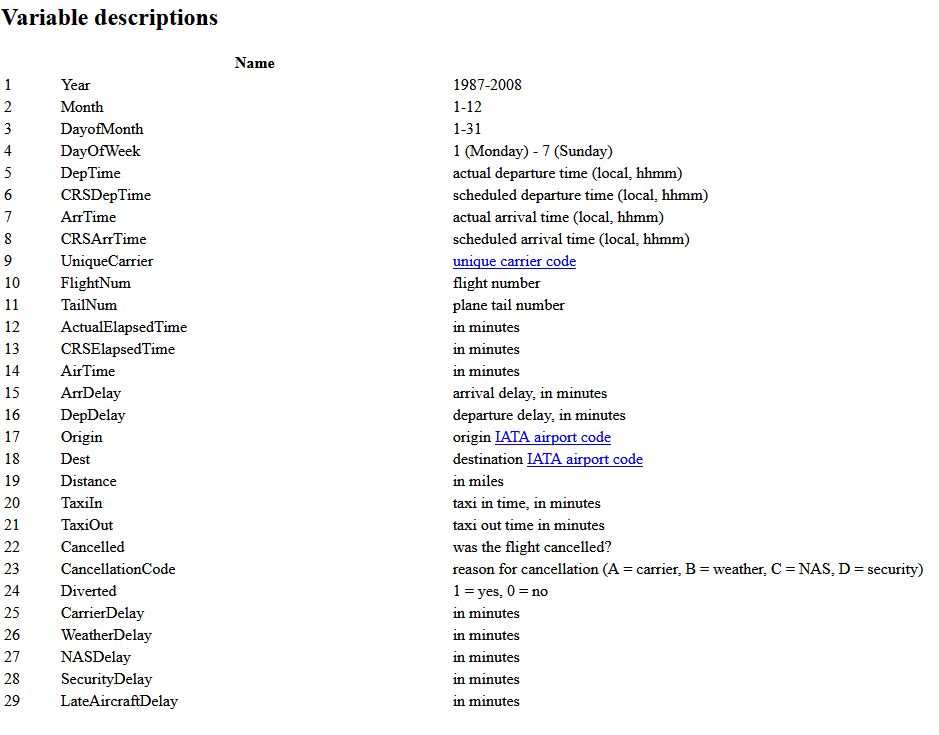



In [4]:
#Vamos a unificar las columnas Year / Month /Day en una sola columna:
df['Date'] = pd.to_datetime(df.Year.astype(str)+ '/' + df.Month.astype(str)+ '/' + df.DayofMonth.astype(str))


## - Exercici 1

Resumeix gràficament el data set DelayedFlights.csv

Crea almenys una visualització per:



### Una variable categòrica (UniqueCarrier)

La mitjana de vols per companyia es:  94050.0


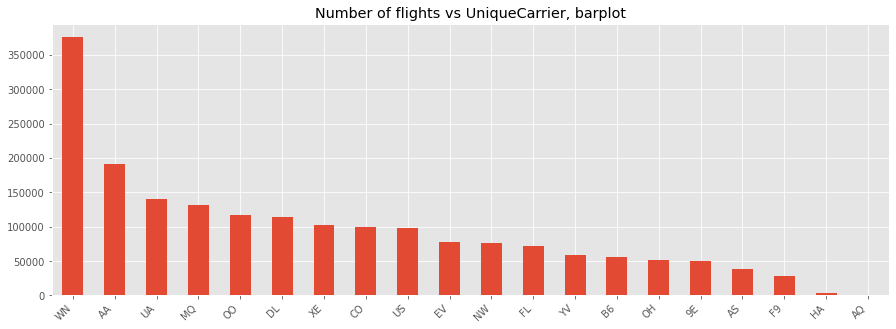

In [5]:
#Explorem primer una variable categòrica, el codi de companyia aèria.
#Podem graficar el número de vegades que es repeteix, que son el número de vols que ha fet cada companyia al dataset (2008):
CountCarrier = df['UniqueCarrier'].value_counts()
CountCarrier.plot(kind='bar');
plt.xticks(rotation=45, ha='right');
print("La mitjana de vols per companyia es: ",CountCarrier.mean())
plt.title("Number of flights vs UniqueCarrier, barplot");
#Exercici 2.- Exporta el gràfic com imatge
plt.savefig('S4T1_1_Number of flights vs UniqueCarrier, barplot.png', bbox_inches='tight')


Veiem que la companyia amb més vols es WN, casi el doble que la segona AA. En canvi HA i AQ quasi no tenen vols en aquest periode 2008.

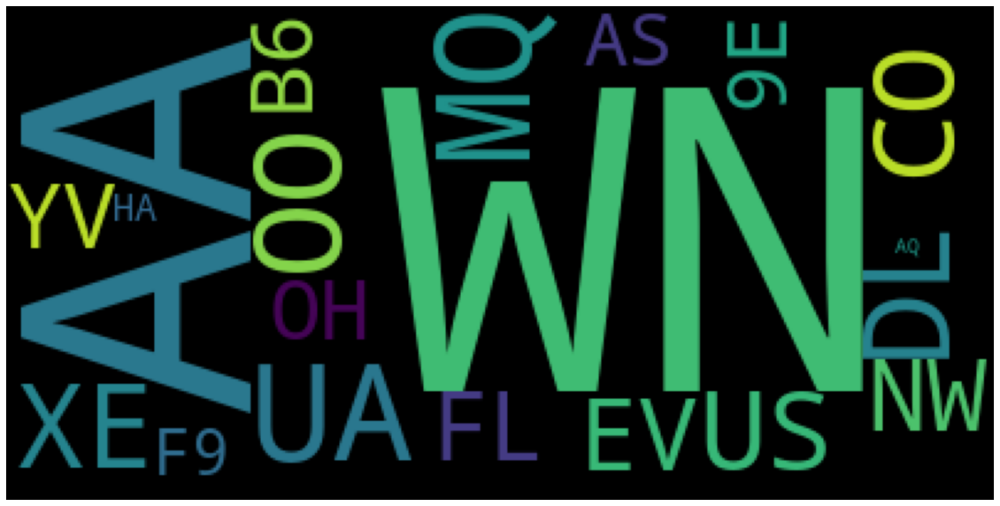

In [6]:
# Anem a fer un gràfic Word cloud també ☁️

from wordcloud import WordCloud # Generate word cloud
text = CountCarrier.to_dict()
#print(text)
wc = WordCloud().generate_from_frequencies(text)

plt.figure(figsize=(20, 30))
plt.imshow(wc)
plt.axis("off") 
#Exercici 2.- Exporta el gràfic com imatge
plt.savefig('S4T1_2_UniqueCarrier_wordcloud.png', bbox_inches='tight')
plt.show()

### Una variable numèrica (ArrDelay)

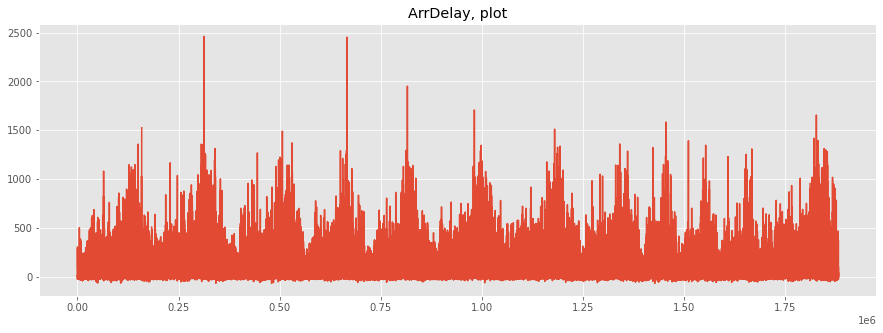

In [7]:
# Podem graficar aquesta variable directament amb un histograma per veure quins valors tenen
df['ArrDelay'].plot();
plt.title("ArrDelay, plot");
#Exercici 2.- Exporta el gràfic com imatge
plt.savefig('S4T1_3_ArrDelay, plot.png', bbox_inches='tight')


Aquí veiem ràpidament els valors que agafa la variable ArrDelay es entre 0 i 2500

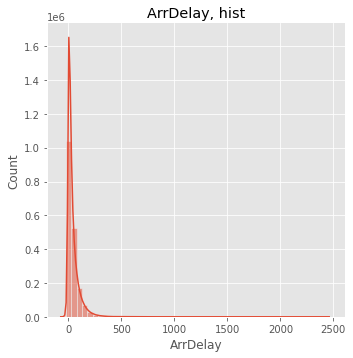

In [8]:
# Dibuixem ArrDelay en histograma
sns.displot(df, x='ArrDelay',binwidth=50, kde=True);
plt.title("ArrDelay, hist");
#Exercici 2.- Exporta el gràfic com imatge
plt.savefig('S4T1_3_2_ArrDelay, plot.png', bbox_inches='tight')

Si fem un histograma, està més clar que casi tots els valors estàn entre 0 i 250 min.

### Una variable numèrica i una categòrica (ArrDelay i UniqueCarrier)

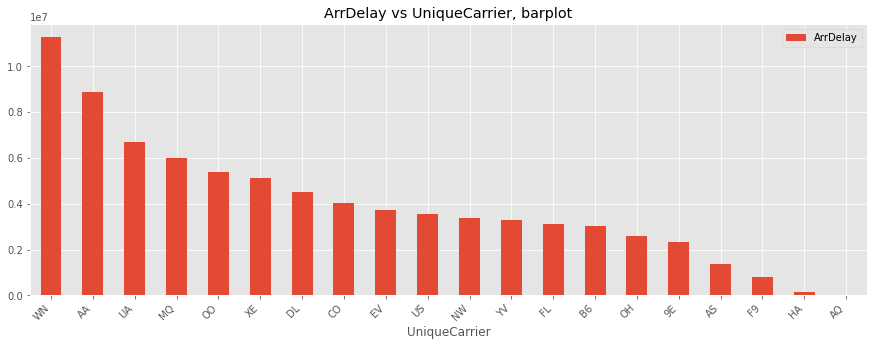

In [9]:
# Grafiquem el ArrDelay per UniqueCarrier
dfAirlines = df[['UniqueCarrier','ArrDelay']].groupby('UniqueCarrier').sum()
dfAirlines.sort_values(by='ArrDelay',ascending=False).plot(kind='bar');
plt.xticks(rotation=45, ha='right');
plt.title("ArrDelay vs UniqueCarrier, barplot");
#Exercici 2.- Exporta el gràfic com imatge
plt.savefig('S4T1_4_ArrDelay vs UniqueCarrier, barplot.png', bbox_inches='tight')

Veiem que la companyia amb més delays es WM (WINDWARD), es esperable ja que també es la companyia amb més vols. Veiem que AA té també un retrás acumulat considerable amb la meitat de vols aprox. que WM. 

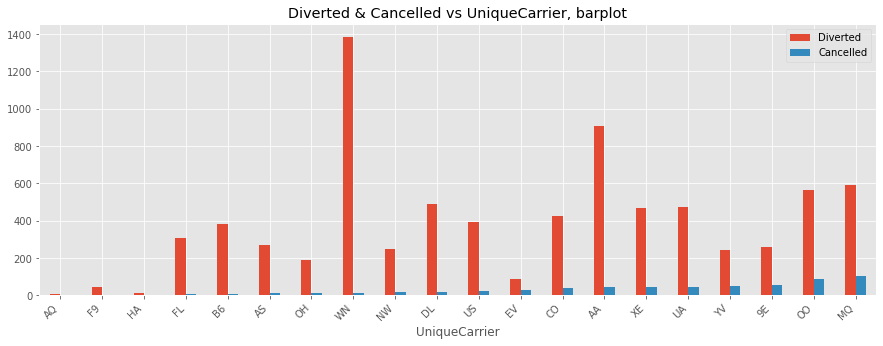

In [10]:
# També explorem el número de vols "Diverted" i "Cancelled" per companyia
dfAirlines = df[['UniqueCarrier','Diverted','Cancelled']].groupby('UniqueCarrier').sum()
dfAirlines.sort_values(by='Cancelled').plot(kind='bar');
plt.xticks(rotation=45, ha='right');
plt.title("Diverted & Cancelled vs UniqueCarrier, barplot");
#Exercici 2.- Exporta el gràfic com imatge
plt.savefig('S4T1_5_Diverted & Cancelled vs UniqueCarrier, barplot.png', bbox_inches='tight')

Veiem que la companya WN es la que té més vols desviats o "Diverted", es normal perque es la que més distància recorreguda té i la que té major número de vols.

En canvi, la companyia que té més vols cancel·lats es MQ (American Eagle Airlines) i només es la quarta companyia amb més vols. Això ja no sembla tan esperable. 

### Dues variables numèriques (ArrDelay i DepDelay)

La correlació entre aquestes dues columnes es de: 0.9524902280116955


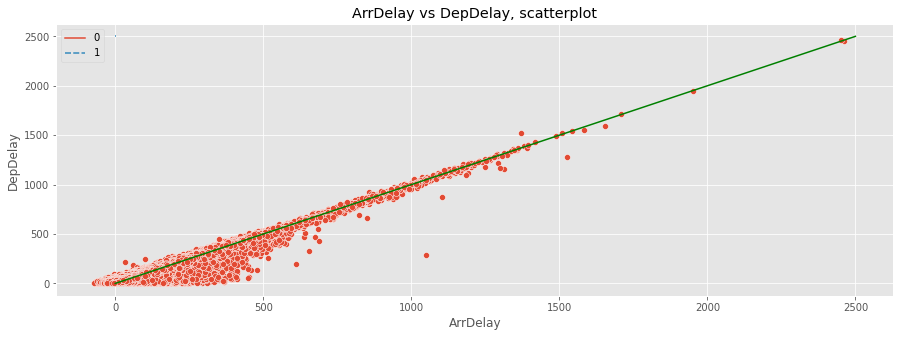

In [11]:
# Grafiquem juntes ArrDelay amb DepDelay per veure si hi ha relació entre elles
# Utilitzem el scatter plot
# Probem a utilitzar seaborn
# sns.regplot(data=df, x="ArrDelay", y="DepDelay"); # Funciona però triga molt.
sns.scatterplot(data=df, x="ArrDelay", y="DepDelay");
plt.title("ArrDelay vs DepDelay, scatterplot");
# Sí que sembla que hi hagi una correlació unitària entre les dues variables.
# Anem a dibuixar la recta de correlació 1.
sns.lineplot(data=[[0,0],[2500,2500]],color='g')
print("La correlació entre aquestes dues columnes es de:",df['ArrDelay'].corr(df['DepDelay']))
line = {'x':[0,2500],'y':[0,2500]}
dline = pd.DataFrame(line)
sns.lineplot(data=dline, x= 'x', y= 'y' ,color='g');
# Plotejem una recta verda directament per apendre i per no utilitzar regplot 
# que triga molt en donar el resultat
#Exercici 2.- Exporta el gràfic com imatge
plt.savefig('S4T1_6_ArrDelay vs DepDelay, scatterplot.png', bbox_inches='tight')

Sí que sembla que hi hagi una correlació unitària entre les dues variables. Es confirma amb la funció .corr = 0.95.

Aquí veiem la correlació entre la variable ArrDelay (retràs a la arribada) i DepDelay (retràs a la sortida). 

Es llògic que si el vol surt més tard, arribi més tard, a no ser que incrementi la seva velocitat, però que no es fa perque gastaría més combustible.

In [12]:
# Intentem utilitzar el gràfic interactiu altair:
#import altair as alt
#alt.Chart(df).mark_circle(size=60).encode(
#    x='ArrDelay',
#    y='DepDelay',
#    color='UniqueCarrier',
#    tooltip=['Name', 'UniqueCarrier', 'ArrDelay', 'DepDelay']
#).interactive()
# No es possible perque està limitat a 5000 rows.

### Tres variables (ArrDelay, DepDelay i UniqueCarrier)

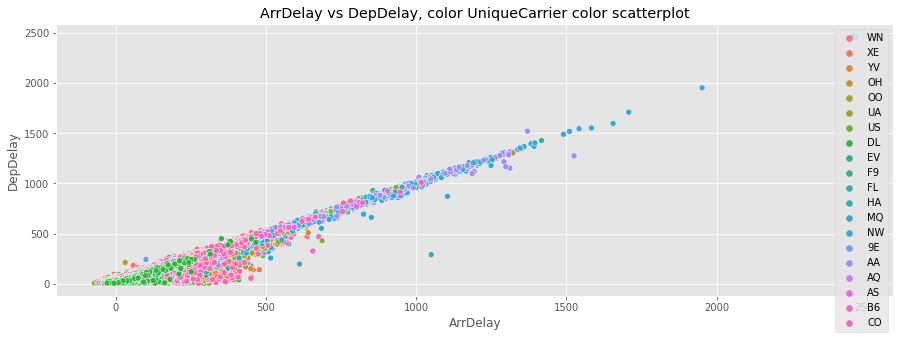

In [13]:
# Per graficar tres variables, utilitzem el scatterplot amb el color diferent
# si es companyia diferent
sns.scatterplot(data=df, x="ArrDelay", y="DepDelay",hue="UniqueCarrier",legend='auto');
plt.legend(loc='upper right');
plt.title("ArrDelay vs DepDelay, color UniqueCarrier color scatterplot");
#Exercici 2.- Exporta el gràfic com imatge
plt.savefig('S4T1_7_ArrDelay vs DepDelay, color UniqueCarrier color scatterplot.png', bbox_inches='tight')

Aquí continuem veient la correlació entre aquestes 2 variables, indepenentment de la companyia que sigui.

### Més de tres variables (ArrDelay, DepDelay, AirTime i UniqueCarrier).

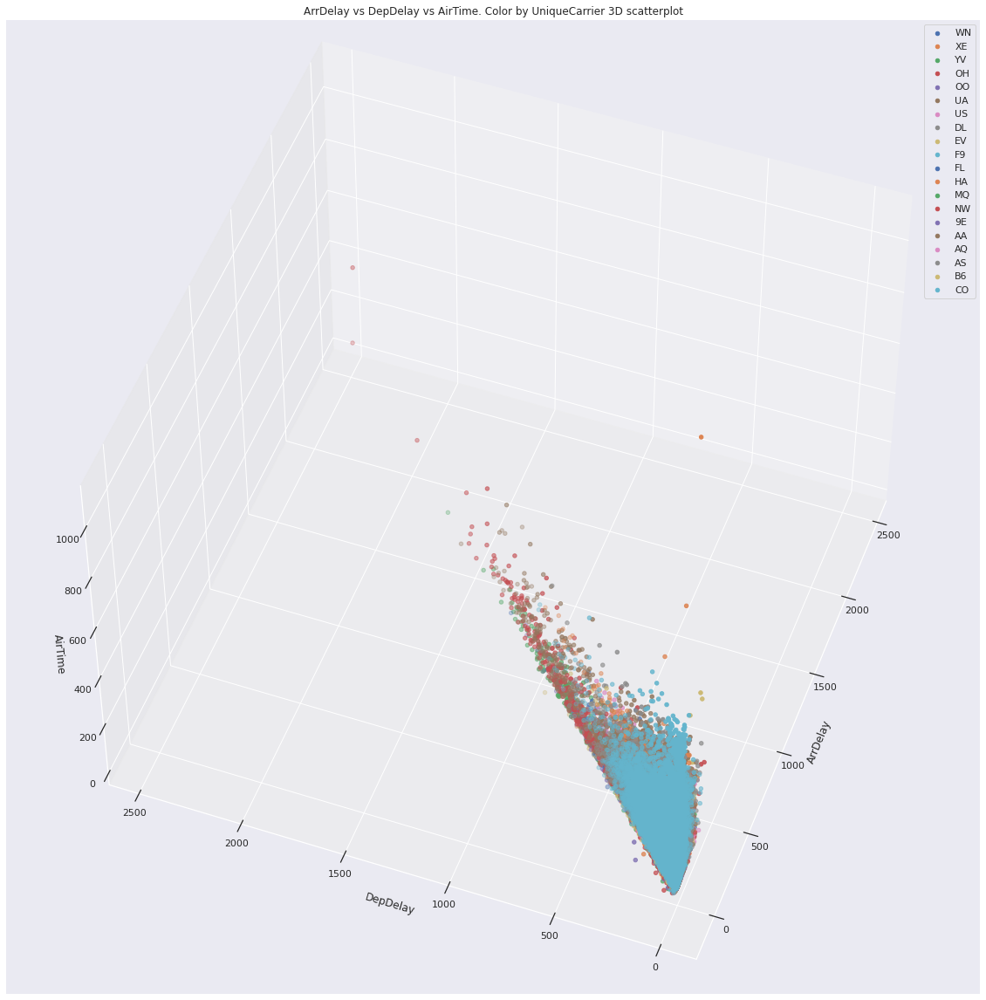

In [14]:
# Per graficar 4 variables utilitzarem un gràfic de 3D amb colors per UniqueCarrier
from mpl_toolkits.mplot3d import Axes3D

sns.set(style = "darkgrid")

fig = plt.figure(figsize=(20,30))
ax = plt.axes(projection='3d')
ax.set_xlabel('ArrDelay')
ax.set_ylabel('DepDelay')
ax.set_zlabel('AirTime')

for Carrier in df.UniqueCarrier.unique():
    ax.scatter(df.ArrDelay[df.UniqueCarrier==Carrier],
               df.DepDelay[df.UniqueCarrier==Carrier],
               df.AirTime[df.UniqueCarrier==Carrier],
               label=Carrier)

ax.legend();
plt.title("ArrDelay vs DepDelay vs AirTime. Color by UniqueCarrier 3D scatterplot");
ax.azim = 200
ax.elev = 50
#Exercici 2.- Exporta el gràfic com imatge
#lt.savefig('S4T1_7_ArrDelay vs DepDelay vs AirTime. Color by UniqueCarrier 3D scatterplot.png', bbox_inches='tight')

Aquí hem fet un scatterplot en 3D però no es veu gaire bé. Probem a fer-ho interactiu.

In [15]:

f = px.scatter_3d(df, x='ArrDelay', y='DepDelay', z='AirTime',
              color='UniqueCarrier')
f.show()

Amb un gràfic 3D interactiu, es pot observar millor, però encara hi així, no es gaire útil per treure conclusions. Crec que sería millor fer separats diferents gràfics amb tres variables. Per exemple:
 *  (ArrDelay vs DepDelay i color UniqueCarrier) (ja fet)
 * (AirTime vs ArrDelay i color UniqueCarrier) 

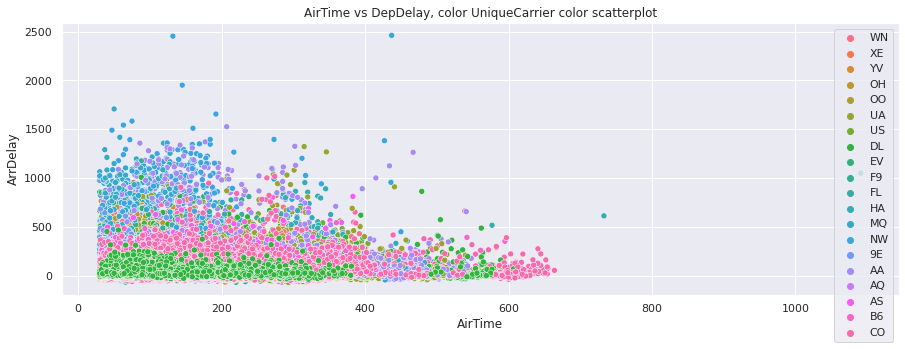

In [38]:
# Per graficar tres variables, utilitzem el scatterplot amb el color diferent
# si es companyia diferent
sns.scatterplot(data=df, x="AirTime", y="ArrDelay",hue="UniqueCarrier",legend='auto');
plt.legend(loc='upper right');
plt.title("AirTime vs DepDelay, color UniqueCarrier color scatterplot");
#Exercici 2.- Exporta el gràfic com imatge
plt.savefig('S4T1_7_2_AirTime vs ArrDelay, color UniqueCarrier color scatterplot.png', bbox_inches='tight')

En aquest gràfic podría que a més AirTime menys ArrDelay. Anem a confirmar-ho o descartar-ho amb la funció correlació:

In [39]:
print("La correlació entre aquestes dues columnes es de:",df['AirTime'].corr(df['ArrDelay']))

La correlació entre aquestes dues columnes es de: -0.0019354056357186297


Aquesta correlació de casi 0 indica que no hi ha cap relació entre ambdues variables.

## - Exercici 2



### Exporta els gràfics com imatges o com html.

In [17]:
# Es fa a cada gràfic amb la funció plt.savefig


## - Exercici 3


### Integra les visualitzacions gràfiques, en la tasca 5, del Sprint 3.

A continuació adjuntem la tasca 5, sprint 3 amb les visualitzacions gràfiques fetes en aquesta tasca.

# Exercici 1: Exploració de dades

Descarrega el data set Airlines Delay: Airline on-time statistics and delay causes i carrega’l a un pandas Dataframe. Explora les dades que conté, i queda’t únicament amb les columnes que consideris rellevants.

In [18]:
# Exploració de les dades
print(df.info(verbose='true',show_counts='true')) 
#df.describe
print(df.head())
print(df.tail())
print ("# Observem que hi han 1.9 Millions de registres i que a les columnes 25 a 29 (index) hi han bastants NaN (0,7M)")
print(df.columns)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1881000 entries, 0 to 1880999
Data columns (total 33 columns):
 #   Column             Non-Null Count    Dtype         
---  ------             --------------    -----         
 0   Unnamed: 0         1881000 non-null  int64         
 1   Year               1881000 non-null  int64         
 2   Month              1881000 non-null  int64         
 3   DayofMonth         1881000 non-null  int64         
 4   DayOfWeek          1881000 non-null  int64         
 5   DepTime            1881000 non-null  float64       
 6   CRSDepTime         1881000 non-null  int64         
 7   ArrTime            1873890 non-null  float64       
 8   CRSArrTime         1881000 non-null  int64         
 9   UniqueCarrier      1881000 non-null  object        
 10  FlightNum          1881000 non-null  int64         
 11  TailNum            1880995 non-null  object        
 12  ActualElapsedTime  1872613 non-null  float64       
 13  CRSElapsedTime     1880802 

Observem que hi han 1.9 Millions de registres i que a les columnes 25 a 29 (index) hi han bastants NaN (0,7M).

In [19]:
# Treiem columnes que no semblen rellevants amb drop (crea una nou df si no es posa inplace=True)
# Treiem la primera columna que es l'index repetit.
print(df.columns)
workdf = df.drop(columns = 'Unnamed: 0',axis=1)
print ("# Treiem la primera columna que es l'index repetit.")
workdf.head()
# Mirem si hi han duplicats
index_dupl_df = workdf.duplicated()
print("Num. duplicats es =", index_dupl_df.sum())
#Només indica que només hi han 2 duplicats, els treiem.
workdf.drop_duplicates()

Index(['Unnamed: 0', 'Year', 'Month', 'DayofMonth', 'DayOfWeek', 'DepTime',
       'CRSDepTime', 'ArrTime', 'CRSArrTime', 'UniqueCarrier', 'FlightNum',
       'TailNum', 'ActualElapsedTime', 'CRSElapsedTime', 'AirTime', 'ArrDelay',
       'DepDelay', 'Origin', 'Dest', 'Distance', 'TaxiIn', 'TaxiOut',
       'Cancelled', 'CancellationCode', 'Diverted', 'CarrierDelay',
       'WeatherDelay', 'NASDelay', 'SecurityDelay', 'LateAircraftDelay',
       'MeanSpeed', 'Delayed', 'Date'],
      dtype='object')
# Treiem la primera columna que es l'index repetit.
Num. duplicats es = 2


,Year,Month,DayofMonth,DayOfWeek,DepTime,CRSDepTime,ArrTime,CRSArrTime,UniqueCarrier,FlightNum,TailNum,ActualElapsedTime,CRSElapsedTime,AirTime,ArrDelay,DepDelay,Origin,Dest,Distance,TaxiIn,TaxiOut,Cancelled,CancellationCode,Diverted,CarrierDelay,WeatherDelay,NASDelay,SecurityDelay,LateAircraftDelay,MeanSpeed,Delayed,Date
0,2008,1,3,4,2003.0,1955,2211.0,2225,WN,335,N712SW,128.0,150.0,116.0,-14.0,8.0,IAD,TPA,810,4.0,8.0,0,N,0,NaN,NaN,NaN,NaN,NaN,419.0,False,2008-01-03
1,2008,1,3,4,754.0,735,1002.0,1000,WN,3231,N772SW,128.0,145.0,113.0,2.0,19.0,IAD,TPA,810,5.0,10.0,0,N,0,NaN,NaN,NaN,NaN,NaN,430.1,True,2008-01-03
2,2008,1,3,4,628.0,620,804.0,750,WN,448,N428WN,96.0,90.0,76.0,14.0,8.0,IND,BWI,515,3.0,17.0,0,N,0,NaN,NaN,NaN,NaN,NaN,406.6,True,2008-01-03
3,2008,1,3,4,1829.0,1755,1959.0,1925,WN,3920,N464WN,90.0,90.0,77.0,34.0,34.0,IND,BWI,515,3.0,10.0,0,N,0,2.0,0.0,0.0,0.0,32.0,401.3,True,2008-01-03
4,2008,1,3,4,1940.0,1915,2121.0,2110,WN,378,N726SW,101.0,115.0,87.0,11.0,25.0,IND,JAX,688,4.0,10.0,0,N,0,NaN,NaN,NaN,NaN,NaN,474.5,True,2008-01-03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1880995,2008,12,13,6,1250.0,1220,1617.0,1552,DL,1621,N938DL,147.0,152.0,120.0,25.0,30.0,MSP,ATL,906,9.0,18.0,0,N,0,3.0,0.0,0.0,0.0,22.0,453.0,True,2008-12-13
1880996,2008,12,13,6,657.0,600,904.0,749,DL,1631,N3743H,127.0,109.0,78.0,75.0,57.0,RIC,ATL,481,15.0,34.0,0,N,0,0.0,57.0,18.0,0.0,0.0,370.0,True,2008-12-13
1880997,2008,12,13,6,1007.0,847,1149.0,1010,DL,1631,N909DA,162.0,143.0,122.0,99.0,80.0,ATL,IAH,689,8.0,32.0,0,N,0,1.0,0.0,19.0,0.0,79.0,338.9,True,2008-12-13
1880998,2008,12,13,6,1251.0,1240,1446.0,1437,DL,1639,N646DL,115.0,117.0,89.0,9.0,11.0,IAD,ATL,533,13.0,13.0,0,N,0,NaN,NaN,NaN,NaN,NaN,359.3,True,2008-12-13


La mitjana de vols per companyia es:  94050.0


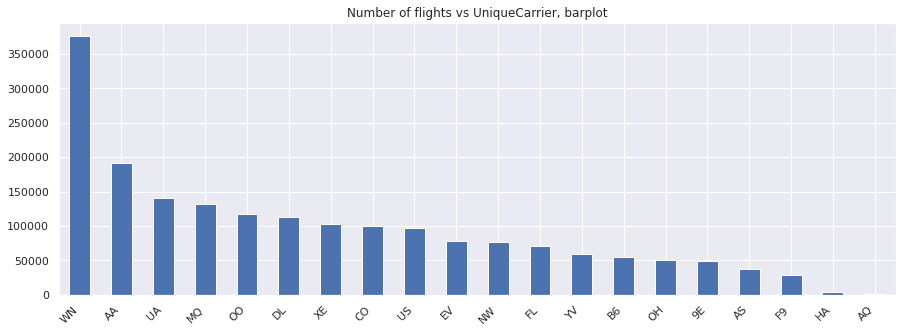

In [20]:
#Explorem primer una variable categòrica, el codi de companyia aèria.
#Podem graficar el número de vols que ha fet cada companyia al dataset (2008):
CountCarrier = df['UniqueCarrier'].value_counts()
CountCarrier.plot(kind='bar');
plt.xticks(rotation=45, ha='right');
print("La mitjana de vols per companyia es: ",CountCarrier.mean())
plt.title("Number of flights vs UniqueCarrier, barplot");


# Exercici 2: Fer informe complet del dataset
---
Fes un informe complet del data set:.

Resumeix estadísticament les columnes d’interès Troba quantes dades faltants hi ha per columna Crea columnes noves (velocitat mitjana del vol, si ha arribat tard o no...) Taula de les aerolínies amb més endarreriments acumulats Quins són els vols més llargs? I els més endarrerits? Etc.

In [21]:
print(workdf.info(verbose='true',show_counts='true')) 
workdf.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1881000 entries, 0 to 1880999
Data columns (total 32 columns):
 #   Column             Non-Null Count    Dtype         
---  ------             --------------    -----         
 0   Year               1881000 non-null  int64         
 1   Month              1881000 non-null  int64         
 2   DayofMonth         1881000 non-null  int64         
 3   DayOfWeek          1881000 non-null  int64         
 4   DepTime            1881000 non-null  float64       
 5   CRSDepTime         1881000 non-null  int64         
 6   ArrTime            1873890 non-null  float64       
 7   CRSArrTime         1881000 non-null  int64         
 8   UniqueCarrier      1881000 non-null  object        
 9   FlightNum          1881000 non-null  int64         
 10  TailNum            1880995 non-null  object        
 11  ActualElapsedTime  1872613 non-null  float64       
 12  CRSElapsedTime     1880802 non-null  float64       
 13  AirTime            1872613 

,Year,Month,DayofMonth,DayOfWeek,DepTime,CRSDepTime,ArrTime,CRSArrTime,FlightNum,ActualElapsedTime,CRSElapsedTime,AirTime,ArrDelay,DepDelay,Distance,TaxiIn,TaxiOut,Cancelled,Diverted,CarrierDelay,WeatherDelay,NASDelay,SecurityDelay,LateAircraftDelay,MeanSpeed
count,1881000.0,1881000.0,1881000.0,1881000.0,1881000.0,1881000.0,1873890.0,1881000.0,1881000.0,1872613.0,1880802.0,1872613.0,1872613.0,1881000.0,1881000.0,1873890.0,1880545.0,1881000.0,1881000.0,1211144.0,1211144.0,1211144.0,1211144.0,1211144.0,1872613.0
mean,2008.0,6.1,15.8,4.0,1518.0,1466.8,1611.0,1636.1,2139.3,135.9,136.9,110.8,42.3,43.3,785.1,6.8,18.3,0.0,0.0,19.0,3.7,15.2,0.1,25.4,400.5
std,0.0,3.5,8.8,2.0,450.3,424.5,549.9,465.3,1919.5,71.5,70.8,68.1,57.0,53.5,571.5,5.3,14.4,0.0,0.1,43.5,21.4,34.0,2.0,42.2,73.1
min,2008.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,35.0,-25.0,30.0,-70.0,6.0,11.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,21.3
25%,2008.0,3.0,8.0,2.0,1203.0,1135.0,1317.0,1326.0,598.0,83.0,85.0,61.0,9.0,12.0,364.0,4.0,10.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,357.0
50%,2008.0,6.0,16.0,4.0,1545.0,1510.0,1717.0,1709.0,1518.0,118.0,120.0,92.0,24.0,24.0,625.0,6.0,14.0,0.0,0.0,2.0,0.0,2.0,0.0,8.0,406.3
75%,2008.0,9.0,23.0,6.0,1900.0,1815.0,2032.0,2015.0,3275.0,167.0,166.0,139.0,56.0,53.0,1009.0,8.0,21.0,0.0,0.0,21.0,0.0,15.0,0.0,33.0,449.5
max,2008.0,12.0,31.0,7.0,2400.0,2359.0,2400.0,2400.0,9742.0,1114.0,660.0,1091.0,2461.0,2467.0,4962.0,240.0,422.0,1.0,1.0,2436.0,1352.0,1357.0,392.0,1316.0,1652.3


## Crea columnes noves (velocitat mitjana del vol, si ha arribat tard o no...) 

### Creem la columna velocitat mitjana MeanSpeed

A primera vista, la columna s'hauria de fer mitjançant Distància \ Temps a l'aire Distance/Airtime*60.

Explorem primer aquestes dues columnes:

In [22]:
print("Distance:")
print(workdf['Distance'].describe())
print("AirTime:")
print(workdf['AirTime'].describe())
workdf.sort_values(by='AirTime').head(10)


Distance:
count   1881000.0
mean        785.1
std         571.5
min          11.0
25%         364.0
50%         625.0
75%        1009.0
max        4962.0
Name: Distance, dtype: float64
AirTime:
count   1872613.0
mean        110.8
std          68.1
min          30.0
25%          61.0
50%          92.0
75%         139.0
max        1091.0
Name: AirTime, dtype: float64


,Year,Month,DayofMonth,DayOfWeek,DepTime,CRSDepTime,ArrTime,CRSArrTime,UniqueCarrier,FlightNum,TailNum,ActualElapsedTime,CRSElapsedTime,AirTime,ArrDelay,DepDelay,Origin,Dest,Distance,TaxiIn,TaxiOut,Cancelled,CancellationCode,Diverted,CarrierDelay,WeatherDelay,NASDelay,SecurityDelay,LateAircraftDelay,MeanSpeed,Delayed,Date
1595223,2008,11,25,2,2044.0,2015,2128.0,2105,WN,2719,N402WN,44.0,50.0,30.0,23.0,29.0,BWI,ORF,159,4.0,10.0,0,N,0,0.0,0.0,0.0,0.0,23.0,318.0,True,2008-11-25
379488,2008,3,16,7,2138.0,2115,2219.0,2200,WN,339,N206WN,41.0,45.0,30.0,19.0,23.0,HOU,AUS,148,5.0,6.0,0,N,0,19.0,0.0,0.0,0.0,0.0,296.0,True,2008-03-16
576569,2008,4,19,6,1647.0,1625,1728.0,1715,WN,1346,N743SW,41.0,50.0,30.0,13.0,22.0,TPA,PBI,174,3.0,8.0,0,N,0,NaN,NaN,NaN,NaN,NaN,348.0,True,2008-04-19
492214,2008,3,3,1,835.0,815,1027.0,1010,MQ,4105,N646AE,52.0,55.0,30.0,17.0,20.0,ORD,FWA,157,5.0,17.0,0,N,0,0.0,0.0,0.0,0.0,17.0,314.0,True,2008-03-03
233282,2008,2,24,7,1818.0,1800,1859.0,1849,OH,5486,N409CA,41.0,49.0,30.0,10.0,18.0,LEX,CVG,70,2.0,9.0,0,N,0,NaN,NaN,NaN,NaN,NaN,140.0,True,2008-02-24
492216,2008,3,11,2,824.0,815,1015.0,1010,MQ,4105,N655AE,51.0,55.0,30.0,5.0,9.0,ORD,FWA,157,4.0,17.0,0,N,0,NaN,NaN,NaN,NaN,NaN,314.0,True,2008-03-11
1747792,2008,12,1,1,1847.0,1728,1944.0,1805,OO,5492,N581SW,57.0,37.0,30.0,99.0,79.0,MRY,SFO,77,4.0,23.0,0,N,0,0.0,0.0,69.0,0.0,30.0,154.0,True,2008-12-01
492224,2008,3,22,6,1531.0,1425,1529.0,1430,MQ,4106,N905JH,58.0,65.0,30.0,59.0,66.0,GRR,ORD,137,15.0,13.0,0,N,0,1.0,0.0,0.0,0.0,58.0,274.0,True,2008-03-22
118992,2008,1,29,2,1230.0,1115,1429.0,1305,MQ,4011,N827AE,59.0,50.0,30.0,84.0,75.0,ORD,FWA,157,10.0,19.0,0,N,0,75.0,0.0,9.0,0.0,0.0,314.0,True,2008-01-29
1005886,2008,6,1,7,2209.0,1950,2256.0,2055,9E,5924,80419E,47.0,65.0,30.0,121.0,139.0,MEM,HSV,184,8.0,9.0,0,N,0,0.0,0.0,0.0,0.0,121.0,368.0,True,2008-06-01


Observem que hi han 7 registres amb valors de Airtime = 0, i també més registres amb valors = 1, 2, 3. Fem un value_counts per tenir l'ordre de magnitud.

In [23]:

workdf.loc[workdf.AirTime < 30, 'AirTime'].value_counts()


Series([], Name: AirTime, dtype: int64)

La columna Airtime té valors 0, 1,2,3,4,5 que no semblen incorrectes.

Finalment decidim la següent Hipòtesis:

Hipòtesis 1.- El temps de un vol d'avió no pot ser inferior a 30 min. Així que eliminem aquests registres amb drop.

In [24]:
workdf.drop(workdf[workdf.AirTime<30].index, inplace=True)
workdf.loc[workdf.AirTime < 30, 'AirTime'].value_counts()

Series([], Name: AirTime, dtype: int64)

Creem la columna velocitat mitjana MeanSpeed. 
Calculem la  Distància \ Temps a l'aire.

count   1872613.0
mean        400.5
std          73.1
min          21.3
25%         357.0
50%         406.3
75%         449.5
max        1652.3
Name: MeanSpeed, dtype: float64


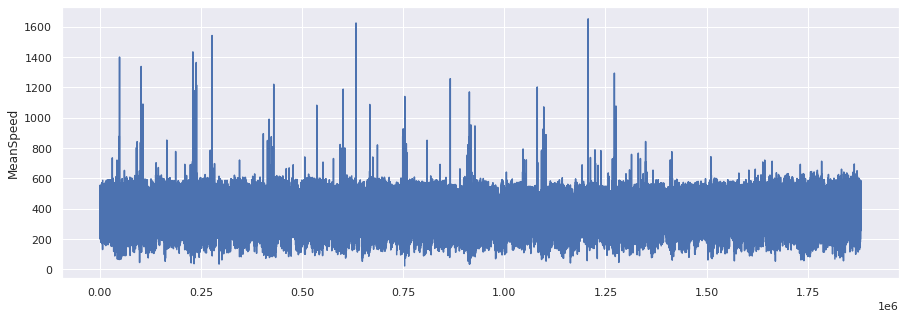

In [25]:
workdf['MeanSpeed'] = workdf['Distance']/workdf['AirTime']*60 # Velocitat mitjana en mph
workdf['MeanSpeed'].plot(ylabel="MeanSpeed")
print(workdf['MeanSpeed'].describe())

Creem la columna Delayed

In [26]:
workdf['Delayed'] = workdf['ArrDelay']> 0
print("El número de vols que han arribat tard es",workdf['Delayed'].sum(),"de",len(workdf))
print("A continuació es mostra el df amb les columnes noves MeanSpeed, Delayed")

workdf.sort_values(by='MeanSpeed',ascending=False)   


El número de vols que han arribat tard es 1670887 de 1881000
A continuació es mostra el df amb les columnes noves MeanSpeed, Delayed


,Year,Month,DayofMonth,DayOfWeek,DepTime,CRSDepTime,ArrTime,CRSArrTime,UniqueCarrier,FlightNum,TailNum,ActualElapsedTime,CRSElapsedTime,AirTime,ArrDelay,DepDelay,Origin,Dest,Distance,TaxiIn,TaxiOut,Cancelled,CancellationCode,Diverted,CarrierDelay,WeatherDelay,NASDelay,SecurityDelay,LateAircraftDelay,MeanSpeed,Delayed,Date
1207400,2008,7,1,2,2237.0,1740,57.0,2038,B6,136,N536JB,140.0,178.0,39.0,259.0,297.0,RSW,JFK,1074,92.0,9.0,0,N,0,0.0,0.0,0.0,0.0,259.0,1652.3,True,2008-07-01
633510,2008,4,20,7,2014.0,1553,408.0,2358,DL,624,N704X,294.0,305.0,83.0,250.0,261.0,LAS,JFK,2248,200.0,11.0,0,N,0,0.0,0.0,0.0,0.0,250.0,1625.1,True,2008-04-20
277696,2008,2,18,1,2000.0,1840,2212.0,2145,EV,4256,N354CA,72.0,125.0,34.0,27.0,80.0,SAT,ATL,874,6.0,32.0,0,N,0,27.0,0.0,0.0,0.0,0.0,1542.4,True,2008-02-18
230253,2008,2,8,5,2025.0,1935,2216.0,2136,OH,5169,N739CA,111.0,121.0,31.0,40.0,50.0,CVG,MHT,741,66.0,14.0,0,N,0,40.0,0.0,0.0,0.0,0.0,1434.2,True,2008-02-08
48911,2008,1,19,6,1625.0,1530,1807.0,1842,OH,5682,N442CA,42.0,132.0,30.0,-35.0,55.0,MSY,CVG,700,5.0,7.0,0,N,0,NaN,NaN,NaN,NaN,NaN,1400.0,False,2008-01-19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1879899,2008,12,10,3,1459.0,1447,NaN,1650,DL,1706,N914DN,NaN,123.0,NaN,NaN,12.0,ATL,BUF,712,NaN,37.0,1,A,0,NaN,NaN,NaN,NaN,NaN,NaN,False,2008-12-10
1879964,2008,12,11,4,1355.0,1106,7.0,1950,DL,26,N3747D,NaN,344.0,NaN,NaN,169.0,LAX,JFK,2475,13.0,17.0,0,N,1,NaN,NaN,NaN,NaN,NaN,NaN,False,2008-12-11
1880123,2008,12,11,4,1026.0,955,NaN,1219,DL,892,N928DL,NaN,144.0,NaN,NaN,31.0,ATL,JFK,760,NaN,NaN,1,A,0,NaN,NaN,NaN,NaN,NaN,NaN,False,2008-12-11
1880225,2008,12,11,4,1527.0,1520,2106.0,1708,DL,1102,N924DL,NaN,108.0,NaN,NaN,7.0,IAD,ATL,533,9.0,19.0,0,N,1,NaN,NaN,NaN,NaN,NaN,NaN,False,2008-12-11


## Taula de les aerolínies amb més endarreriments acumulats Quins són els vols més llargs? I els més endarrerits? Etc.

In [27]:
#Primer de tot, veiem quins son les aerolinies que estàn a les dades
Carriers = workdf['UniqueCarrier'].unique()
print("Hi han",len(Carriers),"companyies aèrees. Son les següents:\n",Carriers)

Hi han 20 companyies aèrees. Son les següents:
 ['WN' 'XE' 'YV' 'OH' 'OO' 'UA' 'US' 'DL' 'EV' 'F9' 'FL' 'HA' 'MQ' 'NW'
 '9E' 'AA' 'AQ' 'AS' 'B6' 'CO']


In [28]:
# Contem quants vols hi han per companyia
CountCarrier = workdf['UniqueCarrier'].value_counts()
CountCarrier

WN    376408
AA    191510
UA    140810
MQ    131579
OO    117008
DL    113535
XE    102666
CO     99409
US     97619
EV     77858
NW     76556
FL     71282
YV     58630
B6     55305
OH     50836
9E     49639
AS     38078
F9     28268
HA      3572
AQ       432
Name: UniqueCarrier, dtype: int64

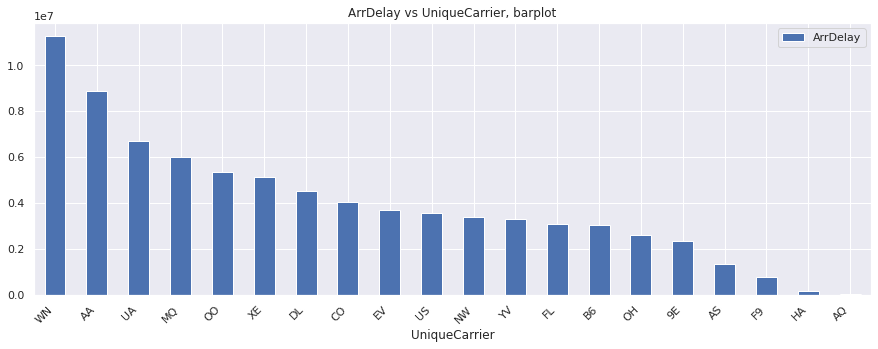

In [29]:
# Grafiquem el ArrDelay per UniqueCarrier
dfAirlines = df[['UniqueCarrier','ArrDelay']].groupby('UniqueCarrier').sum()
dfAirlines.sort_values(by='ArrDelay',ascending=False).plot(kind='bar');
plt.xticks(rotation=45, ha='right');
plt.title("ArrDelay vs UniqueCarrier, barplot");
#Exercici 2.- Exporta el gràfic com imatge
plt.savefig('S4T1_4_ArrDelay vs UniqueCarrier, barplot.png', bbox_inches='tight')

Veiem que la companyia amb més delays es WM (WINDWARD), es esperable ja que també es la companyia amb més vols. Veiem que AA té també un retrás acumulat considerable amb la meitat de vols aprox. que WM. 

A continuació mostrem les companyies ordenades de menys a més endarreriments
WN: Southwest Airlines es la compañia amb més enderreriments però també amb més 
 distància recorreguda.


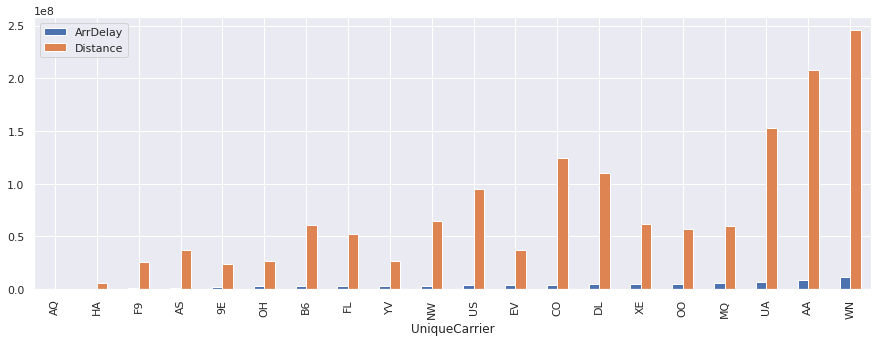

In [30]:
dfAirlines = workdf[['UniqueCarrier','ArrDelay','Distance']].groupby('UniqueCarrier').sum()
print("A continuació mostrem les companyies ordenades de menys a més endarreriments")
print("WN: Southwest Airlines es la compañia amb més enderreriments però també amb més \
\n distància recorreguda.")
dfAirlines.sort_values(by='ArrDelay').plot(kind='bar');

Observem que WN es la companyia que té més vols que cap altre, casi el doble que la anterior AA, i molt més que la resta. Per lo que es normal que tingui més retards que les altres. Hauriem de treure el index de retard / num vols o retard / distància recorreguda per poder tenir una comparació més justa.

In [31]:
# Creem la columna per veure l'index de retard / num vols
for i in CountCarrier.index:
  #dfAirlines['ArrDelay/Counts'][i] = dfAirlines['ArrDelay'][i]/CountCarrier[i]# Dona warning que potser no es fa bé, millor utilitzar .loc
  dfAirlines.loc[i,'ArrDelay/Counts'] = dfAirlines['ArrDelay'][i]/CountCarrier[i]

dfAirlines.sort_values(by='ArrDelay/Counts')

,ArrDelay,Distance,ArrDelay/Counts
UniqueCarrier,,,
AQ,9368.0,631428,21.7
F9,788528.0,25356926,27.9
WN,11284647.0,245567761,30.0
AS,1356222.0,37017469,35.6
US,3543052.0,95148181,36.3
DL,4508682.0,110544942,39.7
CO,4023075.0,124131265,40.5
FL,3100045.0,52185413,43.5
NW,3366483.0,64942333,44.0


Observem que la companyia que acumula més retard / num. vols es YV. 

La que menys es AQ, i WN es la tercera que menys es retrasa per número de vols.

Fent el qüocient del retràs per la distància, veiem que el que menys 
 es retrasa es AQ i el que més es YV.
 WN està per la meitat de la llista en quant a retrassos per distància.


,ArrDelay,Distance,ArrDelay/Counts,ArrDelay/Distance
UniqueCarrier,,,,
AQ,9368.0,631428,21.7,1.5
HA,159978.0,6303888,44.8,2.5
F9,788528.0,25356926,27.9,3.1
CO,4023075.0,124131265,40.5,3.2
AS,1356222.0,37017469,35.6,3.7
US,3543052.0,95148181,36.3,3.7
DL,4508682.0,110544942,39.7,4.1
AA,8875370.0,207547415,46.3,4.3
UA,6705990.0,152647050,47.6,4.4


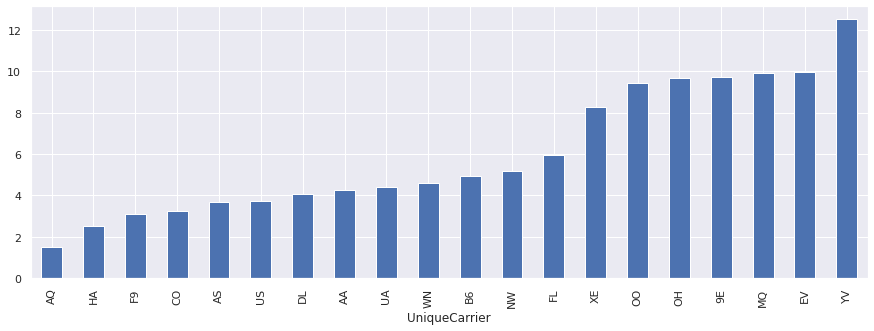

In [32]:
dfAirlines['ArrDelay/Distance'] = dfAirlines['ArrDelay']/dfAirlines['Distance']*100
print("Fent el qüocient del retràs per la distància, veiem que el que menys \n \
es retrasa es AQ i el que més es YV.\n WN està per la meitat de la llista en quant a \
retrassos per distància.")
dfAirlines['ArrDelay/Distance'].sort_values().plot(kind='bar')
dfAirlines.sort_values(by='ArrDelay/Distance')



---


Així podem concloure que YV es la que més retrasa tant per número de vols com per distància recorreguda.

---



In [33]:
workdf.sort_values(by='Distance',ascending=False)
MaxDistance = max(workdf['Distance']) 
print("La màxima distància es:",MaxDistance,"miles")
df_MaxDistance = workdf.loc[workdf['Distance'] == MaxDistance] # %timeit
#Explorem df_MaxDistance i veiem que els vols de EWR a HNL i volta son els més llargs.
print("El vol més llarg es el de:",df_MaxDistance['Origin'].head(1).values,"a",df_MaxDistance['Dest'].head(1).values)
MaxDelay = max(workdf['ArrDelay'])
print("L'enderreriment màxim es:",MaxDelay,"minuts","(",'{0:.2f}'.format(MaxDelay/60),"hores)")

La màxima distància es: 4962 miles
El vol més llarg es el de: ['EWR'] a ['HNL']
L'enderreriment màxim es: 2461.0 minuts ( 41.02 hores)


In [34]:
df_MaxDelay = workdf.loc[workdf['ArrDelay'] == MaxDelay]
print("El delay es per CarrierDelay:",df_MaxDelay['CarrierDelay'].values,"minutes i LateAircraftDelay",df_MaxDelay['LateAircraftDelay'].values)
print("A continuació mostrem els vols ordenades de més a menys endarreriment.")
workdf.sort_values(by='ArrDelay',ascending=False).head(10)

El delay es per CarrierDelay: [1455.] minutes i LateAircraftDelay [1002.]
A continuació mostrem els vols ordenades de més a menys endarreriment.


,Year,Month,DayofMonth,DayOfWeek,DepTime,CRSDepTime,ArrTime,CRSArrTime,UniqueCarrier,FlightNum,TailNum,ActualElapsedTime,CRSElapsedTime,AirTime,ArrDelay,DepDelay,Origin,Dest,Distance,TaxiIn,TaxiOut,Cancelled,CancellationCode,Diverted,CarrierDelay,WeatherDelay,NASDelay,SecurityDelay,LateAircraftDelay,MeanSpeed,Delayed,Date
313245,2008,2,3,7,1117.0,1820,2256.0,555,NW,808,N817NW,459.0,455.0,437.0,2461.0,2457.0,HNL,MSP,3972,6.0,16.0,0,N,0,1455.0,0.0,4.0,0.0,1002.0,545.4,True,2008-02-03
666653,2008,4,10,4,724.0,1417,858.0,1605,NW,1699,N3324L,154.0,168.0,132.0,2453.0,2467.0,CLT,MSP,930,8.0,14.0,0,N,0,2436.0,0.0,0.0,0.0,17.0,422.7,True,2008-04-10
815515,2008,5,6,2,2.0,1530,254.0,1823,NW,1107,N333NW,172.0,173.0,145.0,1951.0,1952.0,RSW,DTW,1085,10.0,17.0,0,N,0,1951.0,0.0,0.0,0.0,0.0,449.0,True,2008-05-06
981081,2008,6,20,5,2140.0,1710,2252.0,1825,MQ,3538,N512AE,72.0,75.0,50.0,1707.0,1710.0,LIT,DFW,304,6.0,16.0,0,N,0,1707.0,0.0,0.0,0.0,0.0,364.8,True,2008-06-20
1826528,2008,12,19,5,1602.0,1325,1921.0,1546,NW,357,N366NW,259.0,201.0,192.0,1655.0,1597.0,BOS,MSP,1124,8.0,59.0,0,N,0,1307.0,0.0,58.0,0.0,290.0,351.2,True,2008-12-19
1454670,2008,9,1,1,906.0,714,1048.0,825,NW,512,N322US,102.0,71.0,75.0,1583.0,1552.0,OMA,MSP,282,4.0,23.0,0,N,0,1552.0,0.0,31.0,0.0,0.0,225.6,True,2008-09-01
666109,2008,4,27,7,1818.0,1633,1942.0,1800,NW,1472,N8986E,84.0,87.0,63.0,1542.0,1545.0,MOT,MSP,449,7.0,14.0,0,N,0,1542.0,0.0,0.0,0.0,0.0,427.6,True,2008-04-27
158725,2008,1,5,6,800.0,1045,1452.0,1327,AA,2398,N622AA,292.0,42.0,207.0,1525.0,1275.0,EGE,MIA,1811,14.0,71.0,0,N,0,1158.0,0.0,117.0,0.0,250.0,524.9,True,2008-01-05
1179440,2008,7,16,3,820.0,702,1325.0,1215,NW,804,N596NW,185.0,193.0,160.0,1510.0,1518.0,SEA,MSP,1399,7.0,18.0,0,N,0,1510.0,0.0,0.0,0.0,0.0,524.6,True,2008-07-16
506500,2008,3,21,5,705.0,615,811.0,721,NW,1743,N786NC,66.0,66.0,47.0,1490.0,1490.0,BNA,MEM,200,5.0,14.0,0,N,0,1490.0,0.0,0.0,0.0,0.0,255.3,True,2008-03-21


Finalment, ràpidament sense profunditzar més. Fent un plot del ArrDelay,
 si les dades estàn ordenades per data, sembla que pugui haver-hi un patró 
de menys a més retràs que es repeteixi...


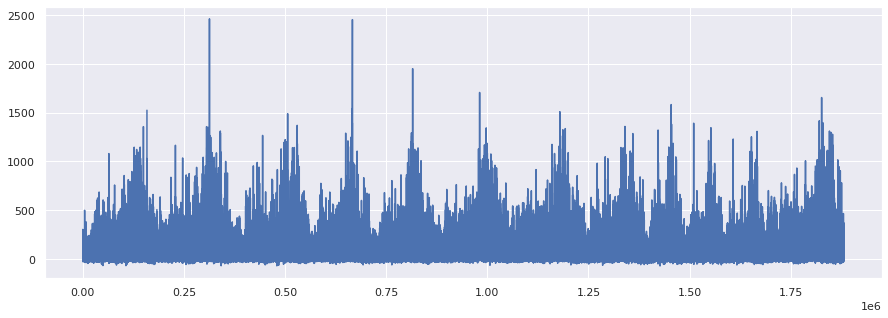

In [35]:
print("Finalment, ràpidament sense profunditzar més. Fent un plot del ArrDelay,\n \
si les dades estàn ordenades per data, sembla que pugui haver-hi un patró \n\
de menys a més retràs que es repeteixi...")
workdf['ArrDelay'].plot();



Fem ara un gràfic de ArrDelay vs DepDelay amb el color UniqueCarrier.

Observem que hi ha una relació quasi lineal entre el retràs d'arribada vs el de sortida, i que aquesta relació es compleix en totes les companyies. 

La companyia amb més retràs acumulat es WN, però com hem comentat anteriorment, es lògic ja que es la que més vols fa.

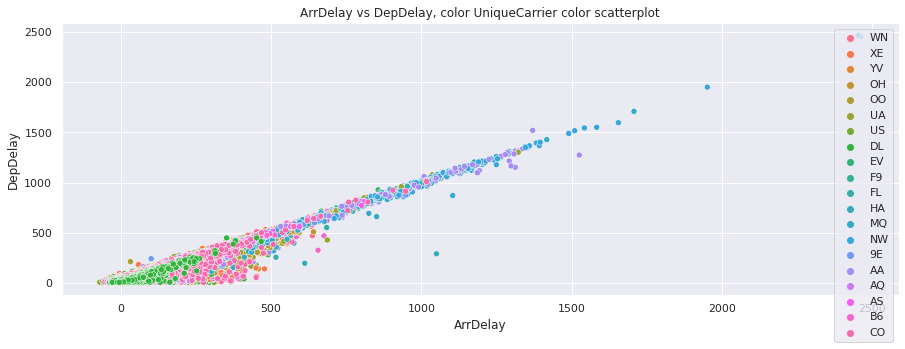

In [36]:
# Per graficar tres variables, utilitzem el scatterplot amb el color diferent
# si es companyia diferent
sns.scatterplot(data=df, x="ArrDelay", y="DepDelay",hue="UniqueCarrier",legend='auto');
plt.legend(loc='upper right');
plt.title("ArrDelay vs DepDelay, color UniqueCarrier color scatterplot");
#Exercici 2.- Exporta el gràfic com imatge
plt.savefig('S4T1_7_ArrDelay vs DepDelay, color UniqueCarrier color scatterplot.png', bbox_inches='tight')

Aquí veiem la correlació entre la variable ArrDelay (retràs a la arribada) i DepDelay (retràs a la sortida), indepenentment de la companyia que sigui. Es llògic que si el vol surt més tard, arribi més tard, a no ser que incrementi la seva velocitat, però que no es fa perque gastaría més combustible.

# Exercici 3: Exportació del dataset net
---
Exporta el data set net i amb les noves columnes a Excel.

In [37]:
# determining the name of the file
file_name1 = './DelayedFlights_processed_1.xlsx'
file_name2 = './DelayedFlights_processed_2.xlsx'
file_name3 = './DelayedFlights_processed_1.csv'  
# saving the excel
# workdf.to_excel(file_name1) # No funciona, màx rows 1M
# print("Hi ha una limitació a Excel, que el màxim de files es 1048576 rows.")
# print("Per lo que creem 2 arxius per exportar el DataFrame")
# workdf.iloc[:1000000].to_excel(file_name1)
# workdf.iloc[1000000:].to_excel(file_name2)
# print('DataFrame is written to Excel File successfully.')
print("Tampoc funciona perque agafa tota la memòria del Colab")
print("Una altra opció es exportar-ho directament a CSV")
workdf.to_csv(file_name3)

Tampoc funciona perque agafa tota la memòria del Colab
Una altra opció es exportar-ho directament a CSV
